#### Windfall Children's Center Propensity to Give
#### Corey J Sinnott
   
## Executive Summary
   
This report was commissioned to develop a model used to predict major donors. A major donor will be considered as any individual likely to give at least 20,000 USD. An initial dataset of ~130,000 donors can be found in the data folder, as well as a dataset containing potential feature values.

## Contents:
- [EDA and Visualizations](#EDA-and-Visualizations)

### Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import profile_report, ProfileReport
from sklearn.preprocessing import StandardScaler
import sweetviz as sv
from sklearn.ensemble import IsolationForest

### Reading in Data

In [2]:
df = pd.read_csv('./data/final_df.csv', index_col = 0)

# EDA and Visualizations

In [3]:
df.describe()

,totalHouseholdDebt,primaryPropertyLoanToValue,primaryPropertyValue,propertyCount,isClassADonor,isClassBDonor,isClassCDonor,isClassDDonor,NetWorth,sumClassADonation,...,maxClassBDonation,maxClassCDonation,maxClassDDonation,sumCauseADonations,sumCauseBDonations,sumCauseCDonations,sumCauseDDonations,sumCauseEDonations,rolling_avg,20k_donor
count,37687.000000,37687.000000,3.768700e+04,37687.000000,37687.000000,37687.000000,37687.000000,37687.000000,3.768700e+04,3.768700e+04,...,3.768700e+04,37687.000000,3.768700e+04,37687.000000,37687.000000,37687.000000,37687.000000,37687.000000,3.768700e+04,37687.000000
mean,4.400262,0.218777,1.247840e+06,1.392337,0.000769,0.512246,0.264176,0.185555,4.427232e+06,1.300606e+03,...,1.560802e+03,198.355294,2.121943e+02,0.271380,0.059718,0.672686,0.420020,0.008512,7.033425e+02,0.021838
std,2.060762,0.230440,1.118400e+06,0.941940,0.027729,0.499857,0.440899,0.388752,2.732548e+07,1.111470e+05,...,1.168996e+05,1738.999881,9.388645e+03,0.773807,0.344408,1.062081,0.872769,0.167259,9.934688e+03,0.146156
min,0.000000,0.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000e+00,1.000000e+00,...,1.000000e+00,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000e-02,0.000000
25%,4.505713,0.021200,6.499340e+05,1.000000,0.000000,0.000000,0.000000,0.000000,1.088610e+06,1.000000e+00,...,1.000000e+00,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,2.528333e+01,0.000000
50%,5.266728,0.148094,9.376400e+05,1.000000,0.000000,1.000000,0.000000,0.000000,2.104011e+06,1.000000e+00,...,6.000000e+00,1.000000,1.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,6.250000e+01,0.000000
75%,5.609056,0.349040,1.473272e+06,2.000000,0.000000,1.000000,1.000000,0.000000,4.552962e+06,1.000000e+00,...,5.100000e+01,11.000000,1.000000e+00,0.000000,0.000000,1.491362,0.000000,0.000000,1.400000e+02,0.000000
max,7.226080,2.266596,2.756721e+07,26.000000,1.000000,1.000000,1.000000,1.000000,3.246186e+09,1.417200e+07,...,1.583275e+07,100001.000000,1.200001e+06,5.485917,4.606392,7.491976,5.996560,5.787978,1.242104e+06,1.000000


### Pandas Profile EDA Report
- HTML doc available in images folder

In [20]:
df.profile_report()

Summarize dataset:   0%|          | 0/39 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [21]:
profile = ProfileReport(df, title='Pandas Profiling Report', explorative=True)

In [6]:
# backing up with HTML copy
# profile.to_file("df_report.html")

### SweetViz Visualization
- HTML doc available in images folder

                                             |          | [  0%]   00:00 -> (? left)


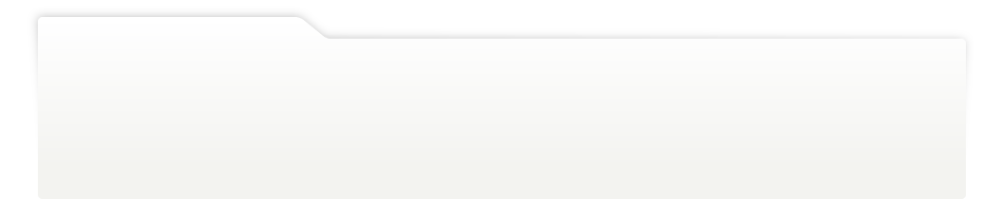
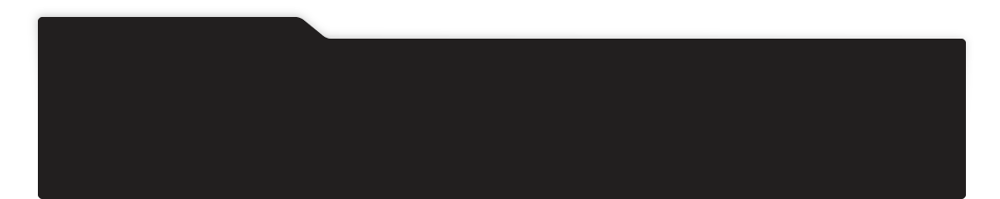
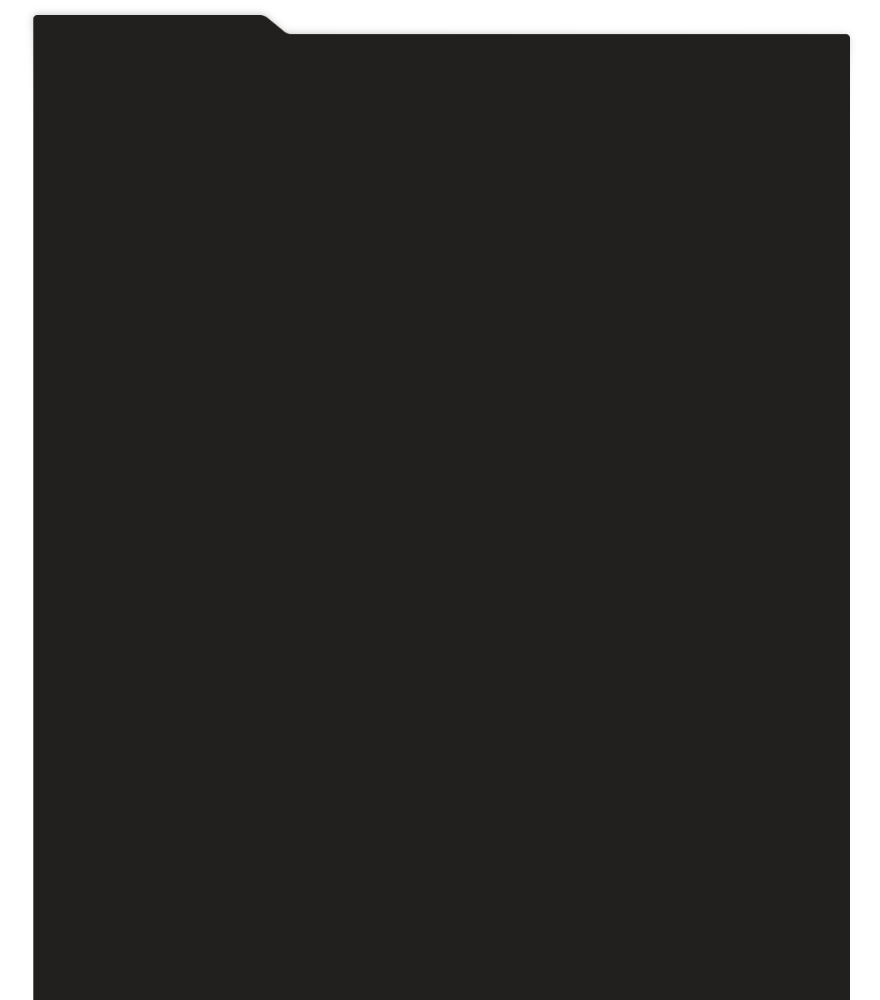
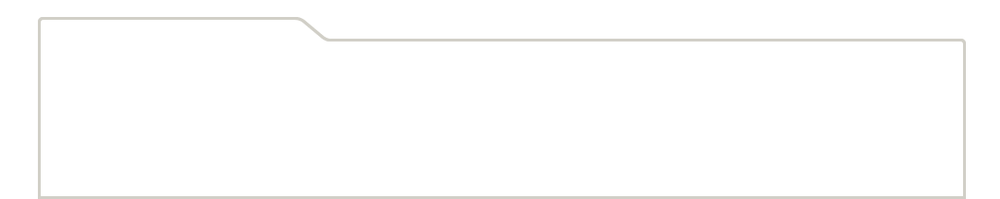
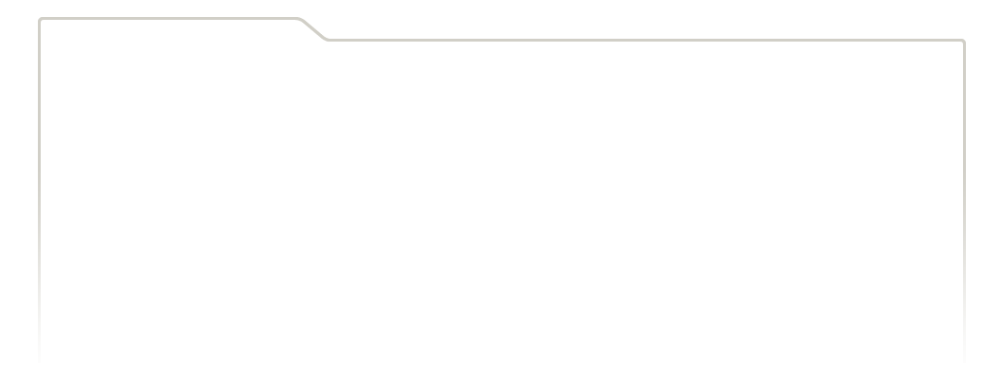
...
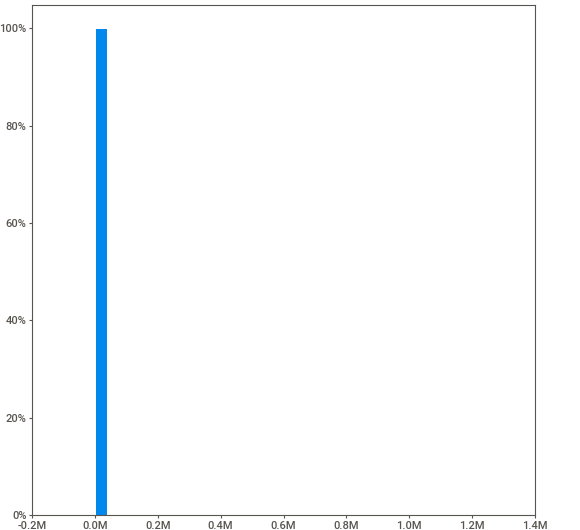
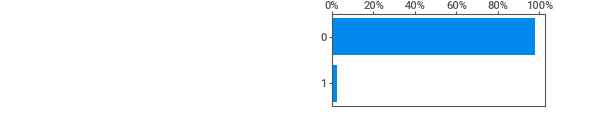
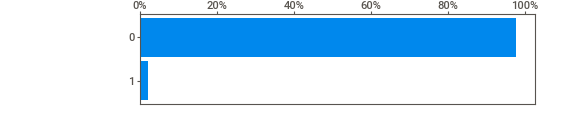
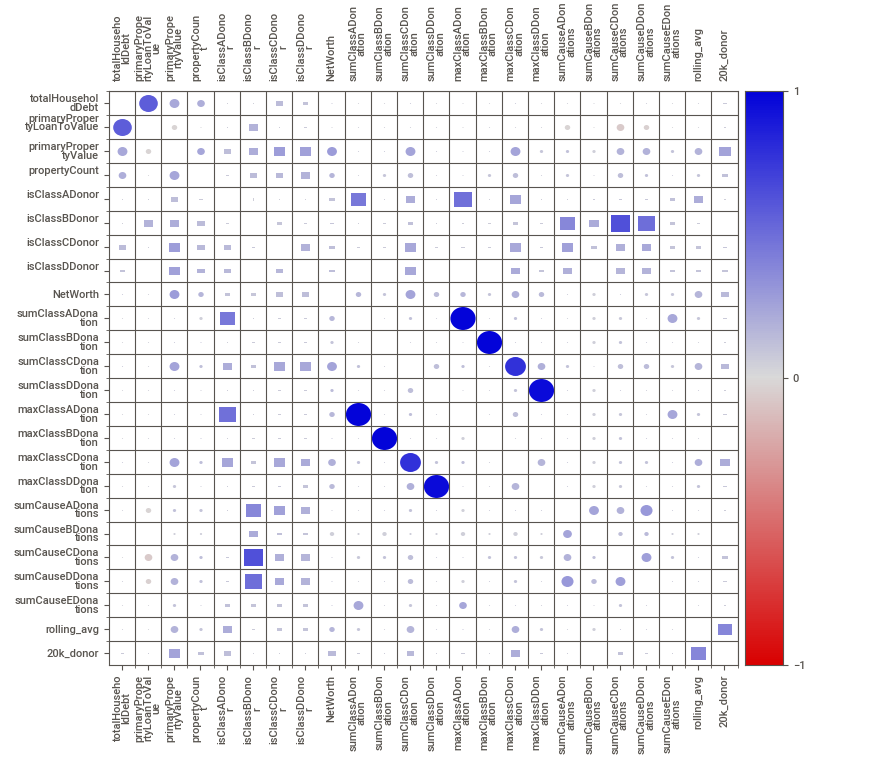
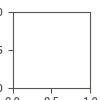

In [4]:
report = sv.analyze(df)
report.show_notebook()

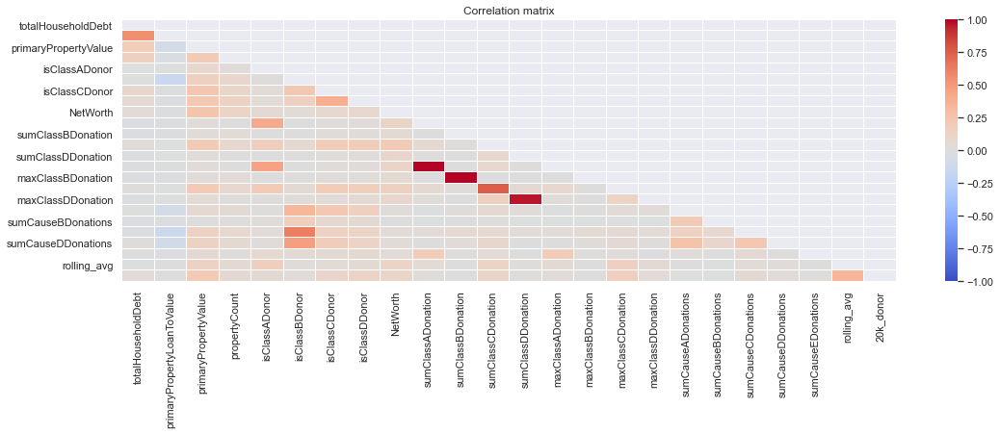

In [12]:
import matplotlib.pyplot as plt
mask = np.zeros_like(df.corr())
mask[np.triu_indices_from(mask)] = True
plt.figure(figsize=(18, 5))
sns.heatmap(
    df.corr(),
    cmap  = 'coolwarm',
    annot = False,
    mask  = mask,
    vmin  = -1.,
    vmax  = 1.,
    linewidths = .01
)
plt.title('Correlation matrix');

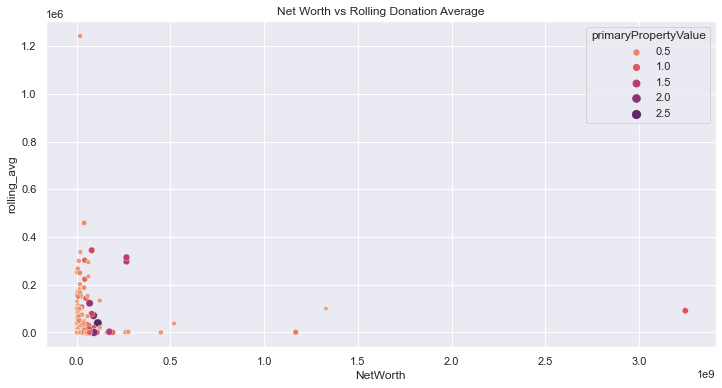

In [15]:
# outliers noted
plt.figure(figsize=(12, 6))
sns.scatterplot(x = df['NetWorth'], y = df['rolling_avg'], 
                hue = df['primaryPropertyValue'], 
                size = df['primaryPropertyValue'],
                palette='flare').set_title("Net worth vs rolling donation average");
sns.set(style='darkgrid')
plt.show()

#### Removing Outliers
- Net worth and rolling average

In [11]:
iso = IsolationForest(n_estimators = 1000, contamination = 0.03)

In [12]:
outs = pd.Series(iso.fit_predict(df[['NetWorth', 'rolling_avg']]), name = 'outliers')

In [13]:
outs.value_counts()

 1    36557
-1     1130
Name: outliers, dtype: int64

In [14]:
df_outliers = pd.concat([outs.reset_index(), df.reset_index()], axis = 1, ignore_index = False).drop(columns = 'index')

In [16]:
df_outliers.head(3)

,outliers,cand_id,totalHouseholdDebt,primaryPropertyLoanToValue,primaryPropertyValue,propertyCount,isClassADonor,isClassBDonor,isClassCDonor,isClassDDonor,...,maxClassBDonation,maxClassCDonation,maxClassDDonation,sumCauseADonations,sumCauseBDonations,sumCauseCDonations,sumCauseDDonations,sumCauseEDonations,rolling_avg,20k_donor
0,-1,candidate_0,6.085778,0.336380,2215000.0,4.0,0.0,0.0,1.0,1.0,...,1.0,751.0,751.0,0.0,0.0,0.000000,0.0,0.0,4965.150833,1
1,-1,candidate_1,6.480672,0.828664,3650000.0,1.0,0.0,1.0,0.0,1.0,...,1751.0,1.0,251.0,0.0,0.0,0.000000,0.0,0.0,25000.000000,1
2,1,candidate_10,4.667154,0.078097,595000.0,1.0,0.0,1.0,0.0,0.0,...,41.0,1.0,1.0,0.0,0.0,2.164353,0.0,0.0,85.000000,0


In [17]:
df_outliers = df_outliers[df_outliers['outliers'] == 1]

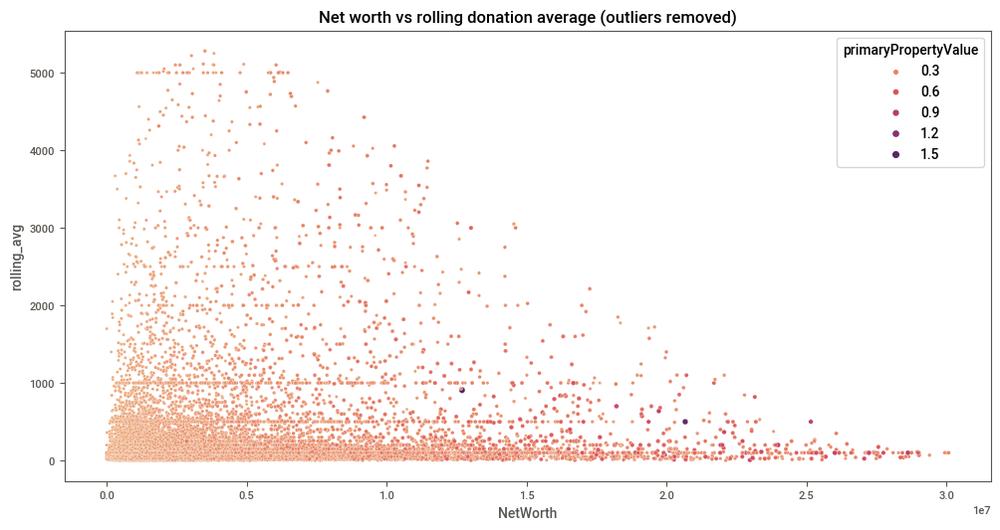

In [18]:
plt.figure(figsize=(12, 6))
sns.scatterplot(x = df_outliers['NetWorth'], y = df_outliers['rolling_avg'], 
                hue = df_outliers['primaryPropertyValue'], 
                size = df_outliers['primaryPropertyValue'],
                palette='flare').set_title("Net worth vs rolling donation average (outliers removed)");
sns.set(style='darkgrid')
plt.show()